In [ ]:
%tensorflow_version 1.x

TensorFlow 1.x selected.


In [ ]:
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
   raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))
print(tf.__version__)

Found GPU at: /device:GPU:0
1.15.2


In [ ]:
!pip install --ignore-installed --upgrade tensorflow-gpu

     |████████████████████████████████| 394.7MB 43kB/s 
     |████████████████████████████████| 61kB 5.6MB/s 
     |████████████████████████████████| 51kB 8.9MB/s 
     |████████████████████████████████| 71kB 10.8MB/s 
     |████████████████████████████████| 471kB 50.9MB/s 
     |████████████████████████████████| 2.9MB 45.6MB/s 
     |████████████████████████████████| 14.5MB 248kB/s 
     |████████████████████████████████| 1.0MB 50.8MB/s 
     |████████████████████████████████| 10.6MB 6.7MB/s 
     |████████████████████████████████| 3.8MB 45.0MB/s 
     |████████████████████████████████| 133kB 54.7MB/s 
     |████████████████████████████████| 102kB 15.1MB/s 
     |████████████████████████████████| 61kB 9.4MB/s 
     |████████████████████████████████| 122kB 57.9MB/s 
     |████████████████████████████████| 788kB 48.5MB/s 
     |████████████████████████████████| 307kB 37.9MB/s 
     |████████████████████████████████| 2.0MB 52.2MB/s 
     |████████████████████████████████| 153kB 56.4MB/s 

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
%cd "/content/gdrive/My Drive/tensorflow"

/content/gdrive/My Drive/tensorflow


In [ ]:
!apt-get install protobuf-compiler python-pil python-lxml python-tk
!pip install Cython

Reading package lists... Done
Building dependency tree       
Reading state information... Done
protobuf-compiler is already the newest version (3.0.0-9.1ubuntu1).
python-tk is already the newest version (2.7.17-1~18.04).
The following additional packages will be installed:
  python-bs4 python-chardet python-html5lib python-olefile
  python-pkg-resources python-six python-webencodings
Suggested packages:
  python-genshi python-lxml-dbg python-lxml-doc python-pil-doc python-pil-dbg
  python-setuptools
The following NEW packages will be installed:
  python-bs4 python-chardet python-html5lib python-lxml python-olefile
  python-pil python-pkg-resources python-six python-webencodings
0 upgraded, 9 newly installed, 0 to remove and 15 not upgraded.
Need to get 1,615 kB of archives.
After this operation, 8,907 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/main amd64 python-bs4 all 4.6.0-1 [67.9 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/main amd

In [ ]:
%cd /content/gdrive/My Drive/tensorflow/models/research/
#!protoc ./object_detection/protos/*.proto --python_out=.

/content/gdrive/My Drive/tensorflow/models/research


In [ ]:
import os
os.environ['PYTHONPATH'] += ':/content/gdrive/My Drive/tensorflow/models/research/:/content/gdrive/My Drive/tensorflow/models/research/slim'

In [ ]:
!python setup.py build
!python setup.py install

running build
running build_py
copying object_detection/train.py -> build/lib/object_detection
copying object_detection/generate_tfrecord.py -> build/lib/object_detection
running egg_info
writing object_detection.egg-info/PKG-INFO
writing dependency_links to object_detection.egg-info/dependency_links.txt
writing requirements to object_detection.egg-info/requires.txt
writing top-level names to object_detection.egg-info/top_level.txt
reading manifest file 'object_detection.egg-info/SOURCES.txt'
writing manifest file 'object_detection.egg-info/SOURCES.txt'
running install
running bdist_egg
running egg_info
writing object_detection.egg-info/PKG-INFO
writing dependency_links to object_detection.egg-info/dependency_links.txt
writing requirements to object_detection.egg-info/requires.txt
writing top-level names to object_detection.egg-info/top_level.txt
reading manifest file 'object_detection.egg-info/SOURCES.txt'
writing manifest file 'object_detection.egg-info/SOURCES.txt'
installing librar

In [ ]:
# 시간 얼마 남았는지 보기
import time, psutil
Start = time.time()- psutil.boot_time()
Left= 12*3600 - Start
print('Time remaining for this session is: ', Left/3600)

Time remaining for this session is:  11.744902758465873


In [ ]:
!pip install tf_slim

     |████████████████████████████████| 358kB 11.9MB/s 


In [ ]:
%cd /content/gdrive/My Drive/tensorflow/models/research/object_detection/builders/
!python model_builder_test.py

/content/gdrive/My Drive/tensorflow/models/research/object_detection/builders


In [ ]:
from xml.etree.ElementTree import parse, Element
import glob

In [ ]:
#%cd "/content/gdrive/My Drive/tensorflow/models/research/object_detection/images/my_test"

/content/gdrive/My Drive/tensorflow/models/research/object_detection/images/my_test


In [ ]:
#for xml_file in glob.glob('/content/gdrive/My Drive/tensorflow/models/research/object_detection/images/my_test/*.xml'):
  doc = parse(xml_file)
  root = doc.getroot()
  root.find('folder').text = 'my_test'
  name = root.find('path').text.split("/")[-1]
  root.find('path').text = "/content/gdrive/My Drive/tensorflow/models/research/object_detection/images/my_test/" + name
  doc.write(name.replace("jpg", "xml"))

In [ ]:
#%cd "/content/gdrive/My Drive/tensorflow/models/research/object_detection/images/my_train"

/content/gdrive/My Drive/tensorflow/models/research/object_detection/images/my_train


In [ ]:
#for xml_file in glob.glob('/content/gdrive/My Drive/tensorflow/models/research/object_detection/images/my_train/*.xml'):
  doc = parse(xml_file)
  root = doc.getroot()
  root.find('folder').text = 'my_train'
  name = root.find('path').text.split("/")[-1]
  root.find('path').text = "/content/gdrive/My Drive/tensorflow/models/research/object_detection/images/my_train/" + name
  doc.write(name.replace("jpg", "xml"))

In [ ]:
import pandas as pd

def xml_to_csv(path):
    xml_list = []
    for xml_file in glob.glob(path + '/*.xml'):
        tree = parse(xml_file)
        root = tree.getroot()
        for member in root.findall('object'):
            value = (root.find('filename').text,
                     int(root.find('size')[0].text),
                     int(root.find('size')[1].text),
                     member[0].text,
                     int(member[4][0].text),
                     int(member[4][1].text),
                     int(member[4][2].text),
                     int(member[4][3].text)
                     )
            xml_list.append(value)
    column_name = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
    xml_df = pd.DataFrame(xml_list, columns=column_name)
    return xml_df

def main(directory_list):
    for Image_cat in directory_list:
        image_path = os.path.join(os.getcwd(), 'images/{}'.format(Image_cat))
        xml_df = xml_to_csv(image_path) 
        xml_df.to_csv('data/{}_labels.csv'.format(Image_cat), index=None)
        print('Successfully converted xml to csv.')

In [ ]:
%cd "/content/gdrive/My Drive/tensorflow/models/research/object_detection/"

/content/gdrive/My Drive/tensorflow/models/research/object_detection


In [ ]:
main(['my_train','my_test'])

Successfully converted xml to csv.
Successfully converted xml to csv.


In [ ]:
# Create train data:
!python generate_tfrecord.py --label="asian woman in pink tshirt" --csv_input="/content/gdrive/My Drive/tensorflow/models/research/object_detection/data/my_train_labels.csv" --img_path="/content/gdrive/My Drive/tensorflow/models/research/object_detection/images/my_train"  --output_path="/content/gdrive/My Drive/tensorflow/models/research/object_detection/data/my_train.record"

# Create test data:
!python generate_tfrecord.py --label="asian woman in pink tshirt" --csv_input="/content/gdrive/My Drive/tensorflow/models/research/object_detection/data/my_test_labels.csv" --img_path="/content/gdrive/My Drive/tensorflow/models/research/object_detection/images/my_test" --output_path="/content/gdrive/My Drive/tensorflow/models/research/object_detection/data/my_test.record"


W1222 22:02:43.451154 140163773364096 module_wrapper.py:139] From generate_tfrecord.py:57: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

Successfully created the TFRecords: /content/gdrive/My Drive/tensorflow/models/research/object_detection/data/my_train.record

W1222 22:02:54.144792 140417977722752 module_wrapper.py:139] From generate_tfrecord.py:57: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

Successfully created the TFRecords: /content/gdrive/My Drive/tensorflow/models/research/object_detection/data/my_test.record


In [ ]:
%load_ext tensorboard
%tensorboard --logdir training/

In [ ]:
!python train.py --logtostderr --train_dir=training/ --pipeline_config_path=training/faster_rcnn_inception_v2_pets.config

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
INFO:tensorflow:global step 32644: loss = 0.0038 (0.186 sec/step)
I1223 09:18:30.988737 140363484874624 learning.py:512] global step 32644: loss = 0.0038 (0.186 sec/step)
INFO:tensorflow:global step 32645: loss = 0.0163 (0.190 sec/step)
I1223 09:18:31.180306 140363484874624 learning.py:512] global step 32645: loss = 0.0163 (0.190 sec/step)
INFO:tensorflow:global step 32646: loss = 0.0088 (0.189 sec/step)
I1223 09:18:31.371204 140363484874624 learning.py:512] global step 32646: loss = 0.0088 (0.189 sec/step)
INFO:tensorflow:global step 32647: loss = 0.0025 (0.171 sec/step)
I1223 09:18:31.544248 140363484874624 learning.py:512] global step 32647: loss = 0.0025 (0.171 sec/step)
INFO:tensorflow:global step 32648: loss = 0.0018 (0.179 sec/step)
I1223 09:18:31.724575 140363484874624 learning.py:512] global step 32648: loss = 0.0018 (0.179 sec/step)
INFO:tensorflow:global step 32649: loss = 0.0022 (0.183 sec/step)
I1223 09:18:31.909503 140363484874624 learn

In [ ]:
!python export_inference_graph.py --input_type image_tensor --pipeline_config_path training/faster_rcnn_inception_v2_pets.config --trained_checkpoint_prefix training/model.ckpt-20297 --output_directory inference_graph

Instructions for updating:
Please use `layer.__call__` method instead.
W1222 23:35:52.848767 139874628974464 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tf_slim/layers/layers.py:2802: Layer.apply (from tensorflow.python.keras.engine.base_layer) is deprecated and will be removed in a future version.
Instructions for updating:
Please use `layer.__call__` method instead.
INFO:tensorflow:Scale of 0 disables regularizer.
I1222 23:35:54.073952 139874628974464 regularizers.py:99] Scale of 0 disables regularizer.
INFO:tensorflow:Scale of 0 disables regularizer.
I1222 23:35:54.207652 139874628974464 regularizers.py:99] Scale of 0 disables regularizer.
INFO:tensorflow:depth of additional conv before box predictor: 0
I1222 23:35:54.208097 139874628974464 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
W1222 23:35:54.264248 139874628974464 deprecati

In [ ]:
######## Image Object Detection Using Tensorflow-trained Classifier #########

# Author: Evan Juras
# Date: 1/15/18
# Description: 
# This program uses a TensorFlow-trained neural network to perform object detection.
# It loads the classifier and uses it to perform object detection on an image.
# It draws boxes, scores, and labels around the objects of interest in the image.

## Some of the code is copied from Google's example at
## https://github.com/tensorflow/models/blob/master/research/object_detection/object_detection_tutorial.ipynb

## and some is copied from Dat Tran's example at
## https://github.com/datitran/object_detector_app/blob/master/object_detection_app.py

## but I changed it to make it more understandable to me.

# Import packages
import os
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
import tensorflow as tf
import sys

# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")

# Import utilites
from utils import label_map_util
from utils import visualization_utils as vis_util
def detection(im_name):
  # Name of the directory containing the object detection module we're using
  MODEL_NAME = 'inference_graph'
  IMAGE_NAME = im_name

  # Grab path to current working directory
  CWD_PATH = os.getcwd()

  # Path to frozen detection graph .pb file, which contains the model that is used
  # for object detection.
  PATH_TO_CKPT = os.path.join(CWD_PATH,MODEL_NAME,'frozen_inference_graph.pb')

  # Path to label map file
  PATH_TO_LABELS = os.path.join(CWD_PATH,'training','labelmap.pbtxt')

  # Path to image
  PATH_TO_IMAGE = os.path.join(CWD_PATH,IMAGE_NAME)

  # Number of classes the object detector can identify
  NUM_CLASSES = 1

  # Load the label map.
  # Label maps map indices to category names, so that when our convolution
  # network predicts `5`, we know that this corresponds to `king`.
  # Here we use internal utility functions, but anything that returns a
  # dictionary mapping integers to appropriate string labels would be fine
  label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
  categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
  category_index = label_map_util.create_category_index(categories)

  # Load the Tensorflow model into memory.
  detection_graph = tf.Graph()
  with detection_graph.as_default():
      od_graph_def = tf.GraphDef()
      with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
          serialized_graph = fid.read()
          od_graph_def.ParseFromString(serialized_graph)
          tf.import_graph_def(od_graph_def, name='')

      sess = tf.Session(graph=detection_graph)

  # Define input and output tensors (i.e. data) for the object detection classifier

  # Input tensor is the image
  image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')

  # Output tensors are the detection boxes, scores, and classes
  # Each box represents a part of the image where a particular object was detected
  detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')

  # Each score represents level of confidence for each of the objects.
  # The score is shown on the result image, together with the class label.
  detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
  detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')

  # Number of objects detected
  num_detections = detection_graph.get_tensor_by_name('num_detections:0')

  # Load image using OpenCV and
  # expand image dimensions to have shape: [1, None, None, 3]
  # i.e. a single-column array, where each item in the column has the pixel RGB value
  image = cv2.imread(PATH_TO_IMAGE)
  image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  image_expanded = np.expand_dims(image_rgb, axis=0)

  # Perform the actual detection by running the model with the image as input
  (boxes, scores, classes, num) = sess.run(
      [detection_boxes, detection_scores, detection_classes, num_detections],
      feed_dict={image_tensor: image_expanded})

  # Draw the results of the detection (aka 'visulaize the results')

  vis_util.visualize_boxes_and_labels_on_image_array(
      image,
      np.squeeze(boxes),
      np.squeeze(classes).astype(np.int32),
      np.squeeze(scores),
      category_index,
      use_normalized_coordinates=True,
      line_thickness=8,
      min_score_thresh=0.60)

  # All the results have been drawn on image. Now display the image.
  cv2_imshow(image)

  # Press any key to close the image
  cv2.waitKey(0)

  # Clean up
  cv2.destroyAllWindows()


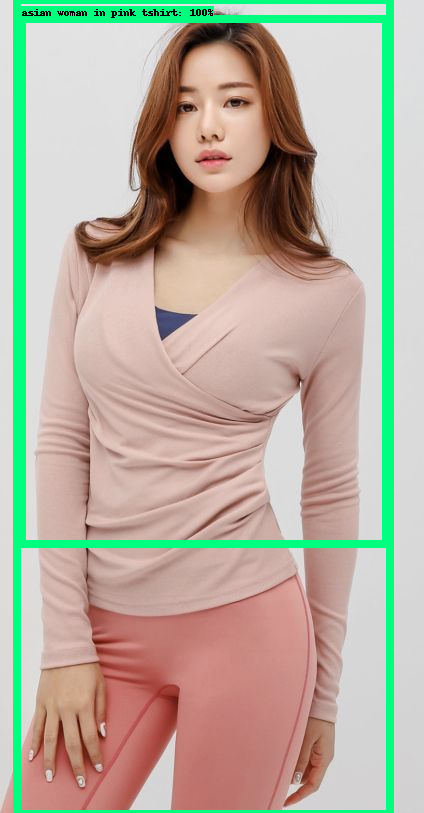

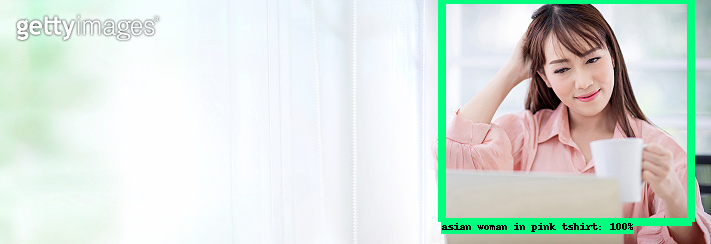

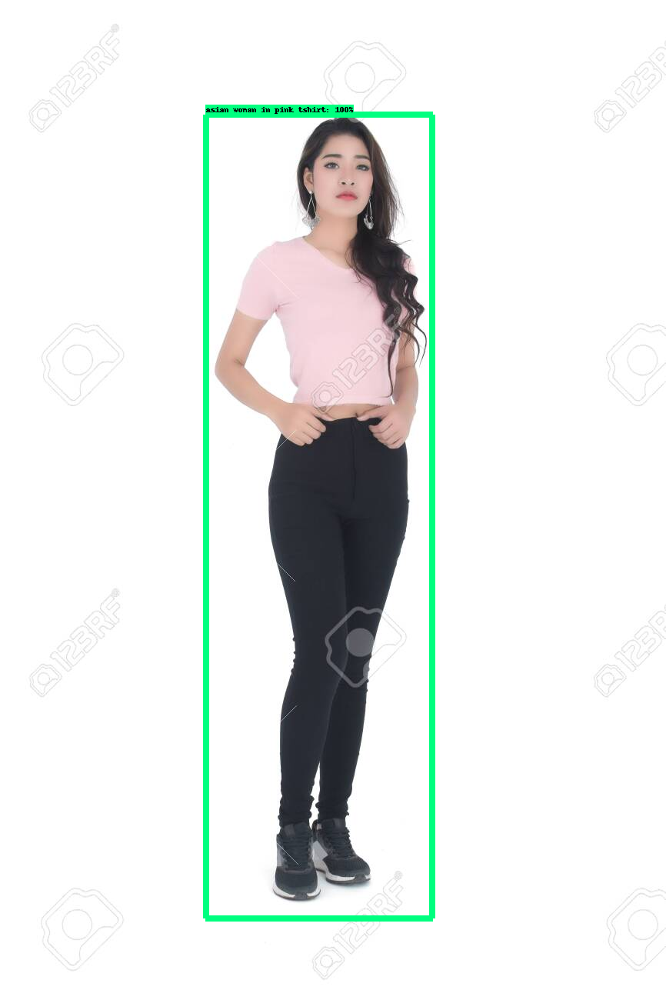

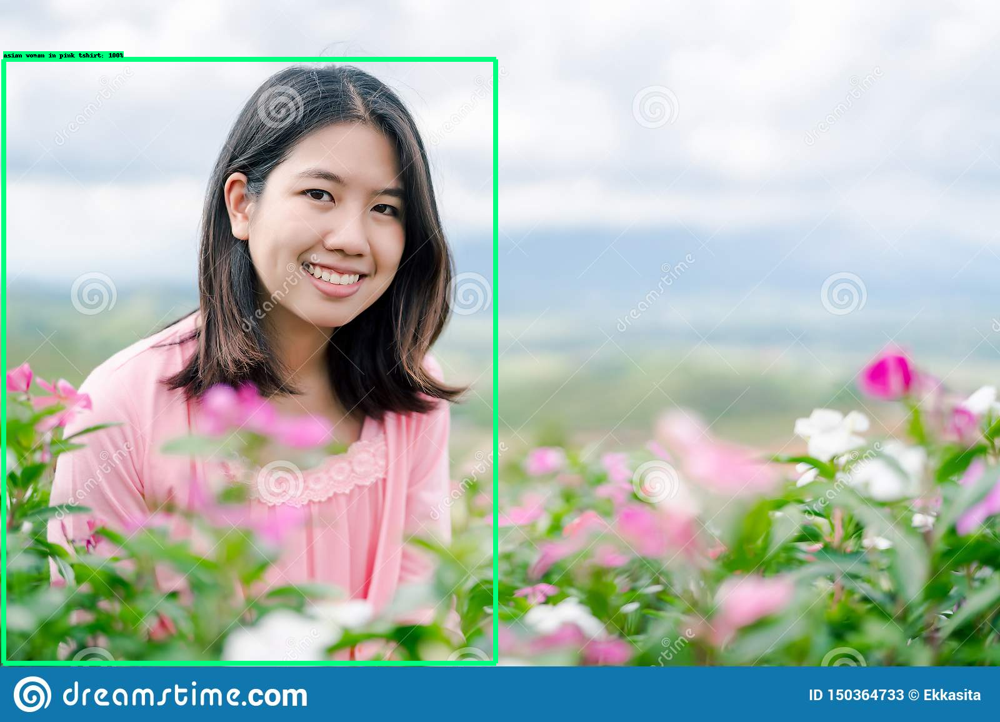

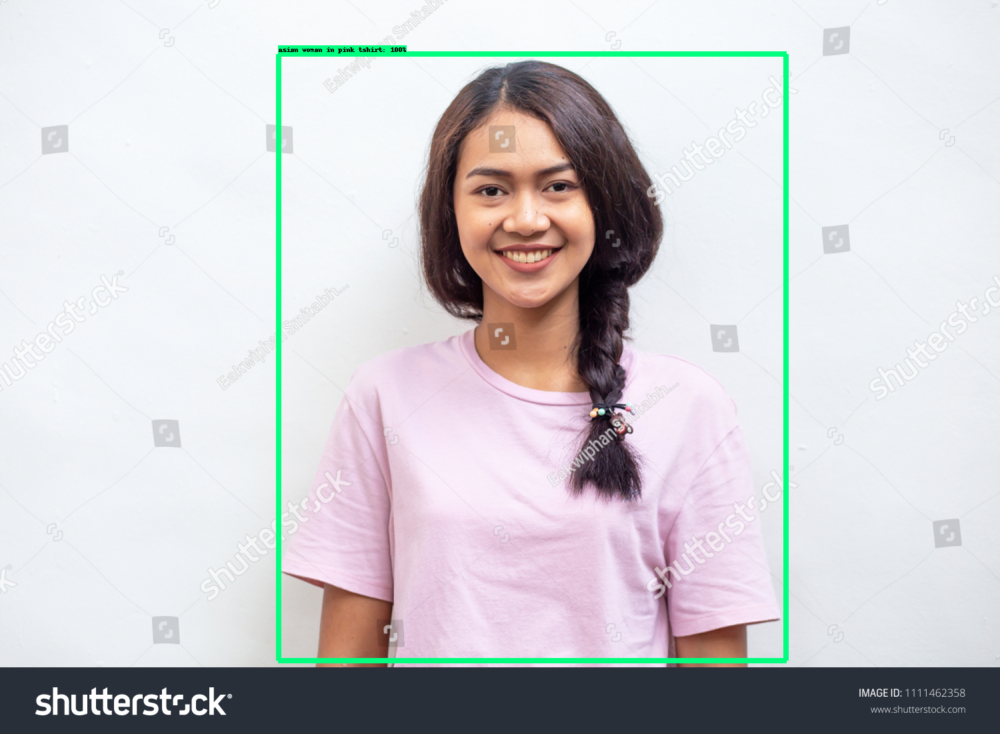

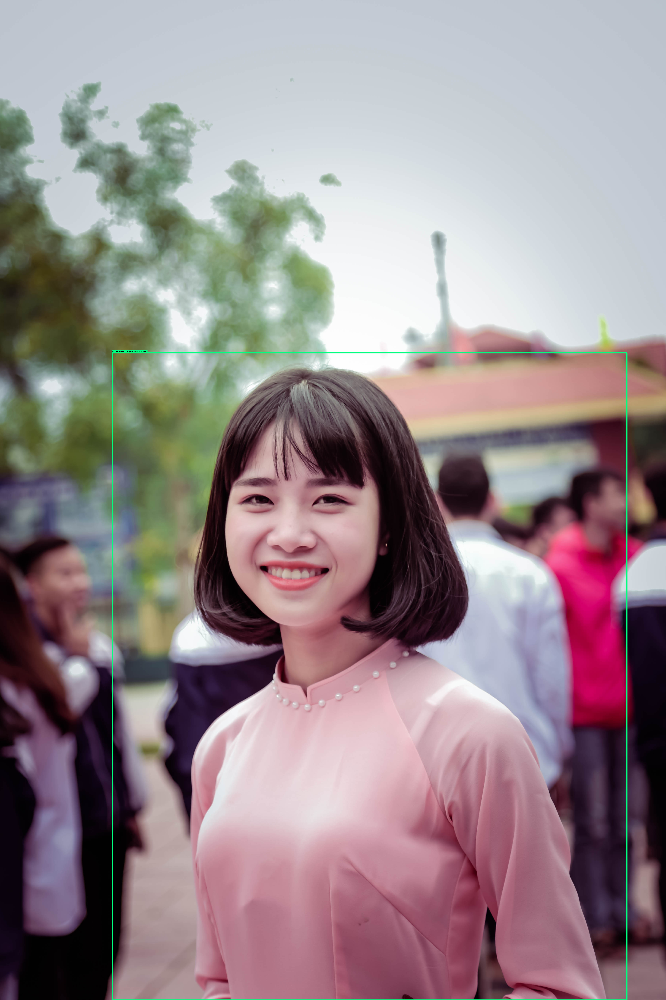

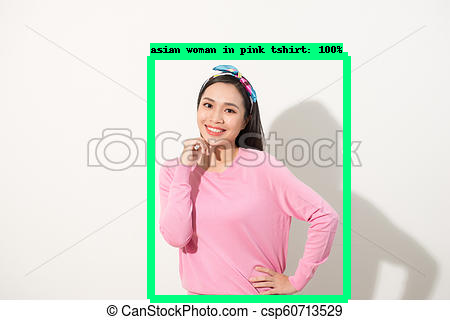

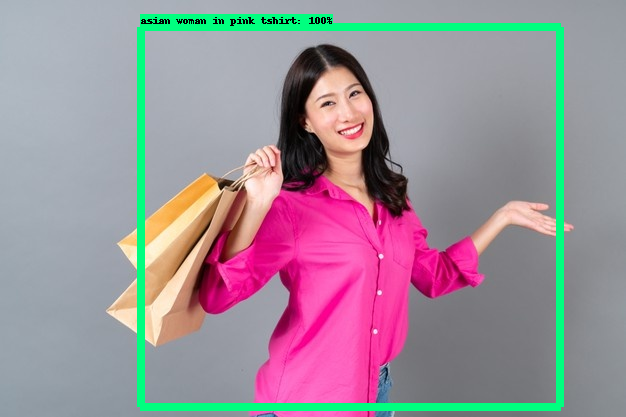

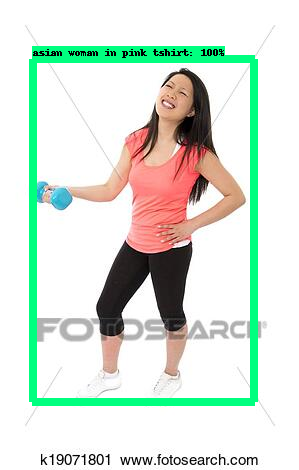

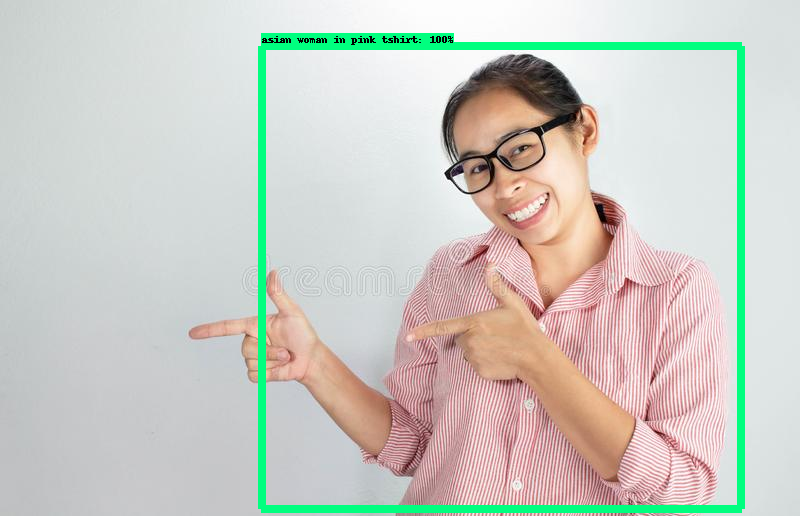

In [ ]:
for im_name in glob.glob("./images/my_test"+"/*.jpg"):
  detection(im_name)

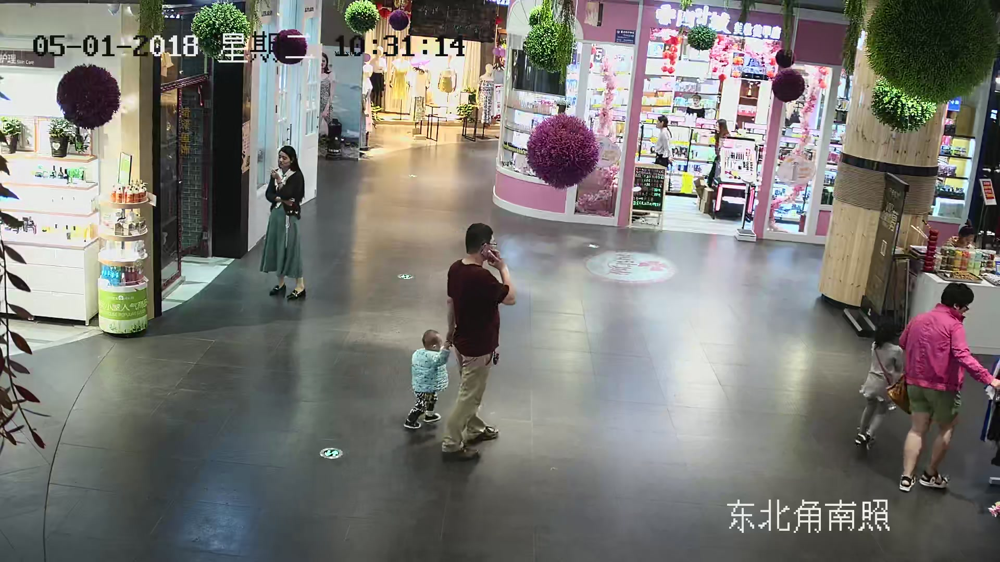

In [ ]:
detection("./images/my_test/00001_market0300017.jpg")

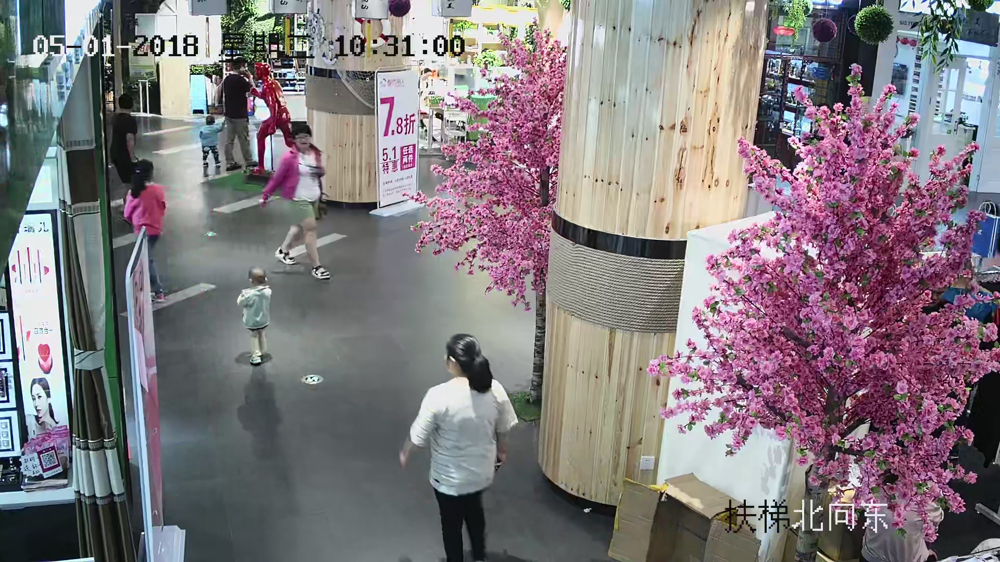

In [ ]:
detection("./images/my_test/00001_market0500006.jpg")